In [19]:
import h5py
import numpy as np
from PIL import Image

train_mat = h5py.File('dataset/matlab/train/digitStruct.mat', 'r')
test_mat = h5py.File('dataset/matlab/val/digitStruct.mat', 'r')

In [23]:
def get_name(index, mat_file):
    name_ref = mat_file['digitStruct']['name'][index][0]
    name = ''.join(chr(c[0]) for c in mat_file[name_ref])
    return name

def get_bbox(index, mat_file):
    bbox_ref = mat_file['digitStruct']['bbox'][index][0]
    bbox = {}

    for attr in ['height', 'label', 'left', 'top', 'width']:
        attr_ref = mat_file[bbox_ref][attr]
        
        if isinstance(attr_ref, h5py.Dataset) and len(attr_ref) > 1:
            bbox[attr] = [mat_file[attr_ref[i][0]][0][0] for i in range(len(attr_ref))]
        else:
            bbox[attr] = [mat_file[attr_ref[0][0]][0][0] if isinstance(attr_ref[0], h5py.Reference) else attr_ref[0][0]]
    
    return bbox


index = 0
image_name = get_name(index, train_mat)
bbox = get_bbox(index, train_mat)

print("Image Name:", image_name)
print("Bounding box:", bbox)

Image Name: 1.png
Bounding box: {'height': [219.0, 219.0], 'label': [1.0, 9.0], 'left': [246.0, 323.0], 'top': [77.0, 81.0], 'width': [81.0, 96.0]}


In [26]:
def convert_to_yolo_format(bbox, image_size):
    image_width, image_height = image_size
    yolo_boxes = []
    
    for i in range(len(bbox['height'])):
        x_center = (bbox['left'][i] + bbox['width'][i] / 2) / image_width
        y_center = (bbox['top'][i] + bbox['height'][i] / 2) / image_height
        width = bbox['width'][i] / image_width
        height = bbox['height'][i] / image_height
        label = int(bbox['label'][i]) - 1
        
        yolo_boxes.append([label, x_center, y_center, width, height])
    
    return yolo_boxes

image_size = Image.open('dataset/images/train/' + image_name).size
convert_to_yolo_format(bbox, image_size)

[[0,
  0.3866396761133603,
  0.5328571428571428,
  0.10931174089068826,
  0.6257142857142857],
 [8,
  0.5006747638326585,
  0.5442857142857143,
  0.12955465587044535,
  0.6257142857142857]]

In [27]:
def make_yolo_labels(images_dir, labels_dir, mat_file):
    total = mat_file['digitStruct']['name'].shape[0]

    for i in range(total):
        image_name = get_name(i, mat_file)
        bounding_boxes = get_bbox(i, mat_file)
        
        image_path = f'{images_dir}/{image_name}'
        image_size = Image.open(image_path).size
        
        yolo_boxes = convert_to_yolo_format(bounding_boxes, image_size)
        
        print(f"Image {i+1}/{total}: {image_name}")
        print("YOLO Bounding Boxes:", yolo_boxes)
        
        yolo_txt_path = f'{labels_dir}/{image_name.replace(".png", ".txt")}'
        with open(yolo_txt_path, 'w') as f:
            for box in yolo_boxes:
                f.write(' '.join(map(str, box)) + '\n')

print("Labeling train images")
make_yolo_labels(
    images_dir='dataset/images/train',
    labels_dir='dataset/labels/train',
    mat_file=train_mat
)
print()
print("Labeling test images")
make_yolo_labels(
    images_dir='dataset/images/val',
    labels_dir='dataset/labels/val',
    mat_file=test_mat
)

Labeling train images
Image 1/33402: 1.png
YOLO Bounding Boxes: [[0, 0.3866396761133603, 0.5328571428571428, 0.10931174089068826, 0.6257142857142857], [8, 0.5006747638326585, 0.5442857142857143, 0.12955465587044535, 0.6257142857142857]]
Image 2/33402: 2.png
YOLO Bounding Boxes: [[1, 0.44472361809045224, 0.5421686746987951, 0.11557788944723618, 0.3855421686746988], [2, 0.5577889447236181, 0.4939759036144578, 0.1306532663316583, 0.3855421686746988]]
Image 3/33402: 3.png
YOLO Bounding Boxes: [[1, 0.40384615384615385, 0.5434782608695652, 0.15384615384615385, 0.6521739130434783], [4, 0.5673076923076923, 0.5434782608695652, 0.17307692307692307, 0.6521739130434783]]
Image 4/33402: 4.png
YOLO Bounding Boxes: [[8, 0.40062111801242234, 0.379746835443038, 0.09316770186335403, 0.43037974683544306], [2, 0.48757763975155277, 0.379746835443038, 0.08074534161490683, 0.43037974683544306]]
Image 5/33402: 5.png
YOLO Bounding Boxes: [[2, 0.44642857142857145, 0.4411764705882353, 0.15, 0.6764705882352942], 

In [28]:
%pip install ultralytics

   ---------------------------------------- 0.0/877.1 kB ? eta -:--:--
   --------------------------------------- 877.1/877.1 kB 19.8 MB/s eta 0:00:00
   ---------------------------------------- 0.0/38.8 MB ? eta -:--:--
   --- ------------------------------------ 3.1/38.8 MB 15.3 MB/s eta 0:00:03
   ------- -------------------------------- 7.6/38.8 MB 18.0 MB/s eta 0:00:02
   ------------ --------------------------- 11.8/38.8 MB 18.5 MB/s eta 0:00:02
   --------------- ------------------------ 15.2/38.8 MB 18.0 MB/s eta 0:00:02
   ------------------- -------------------- 18.9/38.8 MB 17.8 MB/s eta 0:00:02
   ----------------------- ---------------- 22.5/38.8 MB 17.6 MB/s eta 0:00:01
   -------------------------- ------------- 26.2/38.8 MB 17.7 MB/s eta 0:00:01
   ----------------------------- ---------- 29.1/38.8 MB 17.2 MB/s eta 0:00:01
   -------------------------------- ------- 31.2/38.8 MB 16.4 MB/s eta 0:00:01
   --------------------------------- ------ 32.8/38.8 MB 15.5 MB/s eta

In [31]:
from ultralytics import YOLO

model = YOLO('yolov8n.pt')

model.train(
    data='dataset.yaml',
    epochs=10,
    imgsz=640,
    batch=8,
    name='numbers_yolo',
    workers=2,
    device=0
)

New https://pypi.org/project/ultralytics/8.3.22 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.21  Python-3.8.10 torch-2.4.1+cu118 CUDA:0 (NVIDIA GeForce MX350, 2048MiB)
engine\trainer: task=detect, mode=train, model=yolov8n.pt, data=dataset.yaml, epochs=10, time=None, patience=100, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=0, workers=2, project=None, name=numbers_yolo2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=Fa

100%|██████████| 755k/755k [00:00<00:00, 14.5MB/s]


Overriding model.yaml nc=80 with nc=10

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytic

100%|██████████| 5.35M/5.35M [00:00<00:00, 12.5MB/s]


AMP: checks passed 


train: Scanning D:\ml-advanced-course\lab2\detection\dataset\labels\train... 33402 images, 0 backgrounds, 1 corrupt: 100%|██████████| 33402/33402 [00:16<00:00, 2008.90it/s]

train: WARNING  D:\ml-advanced-course\lab2\detection\dataset\images\train\12668.png: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.3077]


train: New cache created: D:\ml-advanced-course\lab2\detection\dataset\labels\train.cache


val: Scanning D:\ml-advanced-course\lab2\detection\dataset\labels\val... 13068 images, 0 backgrounds, 1 corrupt: 100%|██████████| 13068/13068 [00:06<00:00, 1891.60it/s]

val: WARNING  D:\ml-advanced-course\lab2\detection\dataset\images\val\3192.png: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0152]


val: New cache created: D:\ml-advanced-course\lab2\detection\dataset\labels\val.cache
Plotting labels to runs\detect\numbers_yolo2\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000714, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added 
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs\detect\numbers_yolo2
Starting training for 10 epochs...
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10      1.29G      1.755      2.022      1.525          2        640: 100%|██████████| 4176/4176 [40:12<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 817/817 [04:28<00:00,  3.04it/s]


                   all      13067      26030      0.799      0.674      0.756      0.341

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10      1.31G      1.693      1.148      1.443          2        640: 100%|██████████| 4176/4176 [40:19<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 817/817 [04:14<00:00,  3.21it/s]


                   all      13067      26030      0.836       0.74      0.819      0.371

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10       1.3G      1.678      1.019      1.432          1        640: 100%|██████████| 4176/4176 [37:28<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 817/817 [04:07<00:00,  3.30it/s]


                   all      13067      26030      0.847      0.765      0.835      0.387

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10      1.28G      1.667     0.9546      1.423          2        640: 100%|██████████| 4176/4176 [37:52<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 817/817 [03:55<00:00,  3.47it/s]


                   all      13067      26030      0.851      0.774       0.84      0.393

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10      1.29G      1.652     0.9078      1.415          2        640: 100%|██████████| 4176/4176 [37:30<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 817/817 [03:55<00:00,  3.47it/s]


                   all      13067      26030      0.875      0.799      0.861      0.404

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10      1.28G      1.642     0.8645      1.404          2        640: 100%|██████████| 4176/4176 [37:26<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 817/817 [03:54<00:00,  3.48it/s]


                   all      13067      26030      0.873      0.813      0.867      0.411

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10      1.28G      1.633     0.8365      1.398          1        640: 100%|██████████| 4176/4176 [37:28<00:00,  1.86it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 817/817 [03:53<00:00,  3.51it/s]


                   all      13067      26030      0.886      0.816      0.874      0.416

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10      1.28G      1.623     0.8042      1.394          3        640: 100%|██████████| 4176/4176 [37:32<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 817/817 [04:00<00:00,  3.40it/s]


                   all      13067      26030      0.887      0.839      0.884      0.416

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10      1.28G      1.612     0.7782      1.387          2        640: 100%|██████████| 4176/4176 [37:59<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 817/817 [04:11<00:00,  3.25it/s]


                   all      13067      26030      0.895       0.84      0.887      0.421

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10      1.28G      1.601     0.7573      1.379          2        640: 100%|██████████| 4176/4176 [38:00<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 817/817 [04:03<00:00,  3.36it/s]


                   all      13067      26030      0.892      0.841      0.887      0.423

10 epochs completed in 7.054 hours.
Optimizer stripped from runs\detect\numbers_yolo2\weights\last.pt, 6.2MB
Optimizer stripped from runs\detect\numbers_yolo2\weights\best.pt, 6.2MB

Validating runs\detect\numbers_yolo2\weights\best.pt...
Ultralytics 8.3.21  Python-3.8.10 torch-2.4.1+cu118 CUDA:0 (NVIDIA GeForce MX350, 2048MiB)
Model summary (fused): 168 layers, 3,007,598 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 817/817 [03:56<00:00,  3.45it/s]


                   all      13067      26030      0.892      0.841      0.888      0.423
                     0       4578       5099      0.871      0.749      0.829      0.342
                     1       3833       4148      0.904      0.874      0.912      0.441
                     2       2696       2882      0.883      0.798      0.872      0.421
                     3       2397       2523      0.916      0.858      0.896      0.414
                     4       2289       2383      0.919      0.845      0.899       0.44
                     5       1922       1977      0.858      0.846      0.877      0.431
                     6       1943       2019      0.893      0.864      0.897      0.418
                     7       1612       1660      0.897      0.852      0.898      0.438
                     8       1555       1595       0.89      0.841      0.888      0.437
                     9       1687       1744      0.888      0.882      0.909      0.447
Speed: 0.4ms preproce

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x000002B039A3AA90>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,   

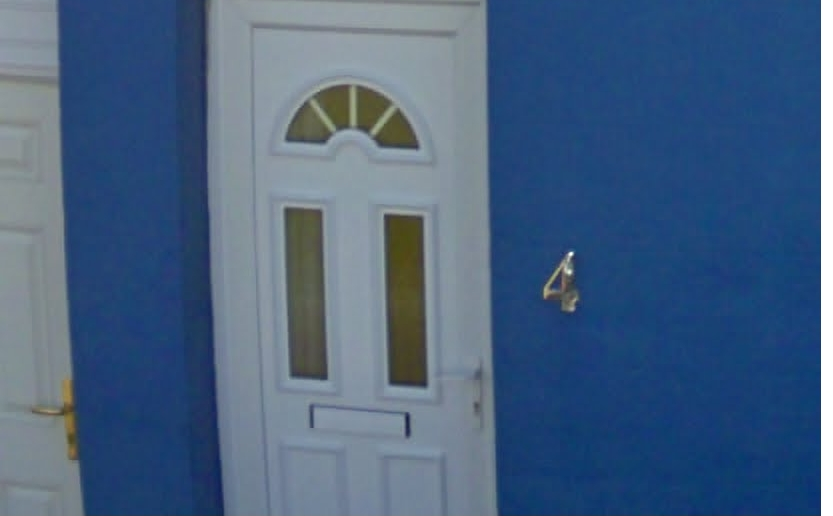

In [124]:
import matplotlib.pyplot as plt

img = Image.open('dataset/images/val/15.png')
img


0: 416x640 1 3, 69.4ms
Speed: 161.2ms preprocess, 69.4ms inference, 0.0ms postprocess per image at shape (1, 3, 416, 640)


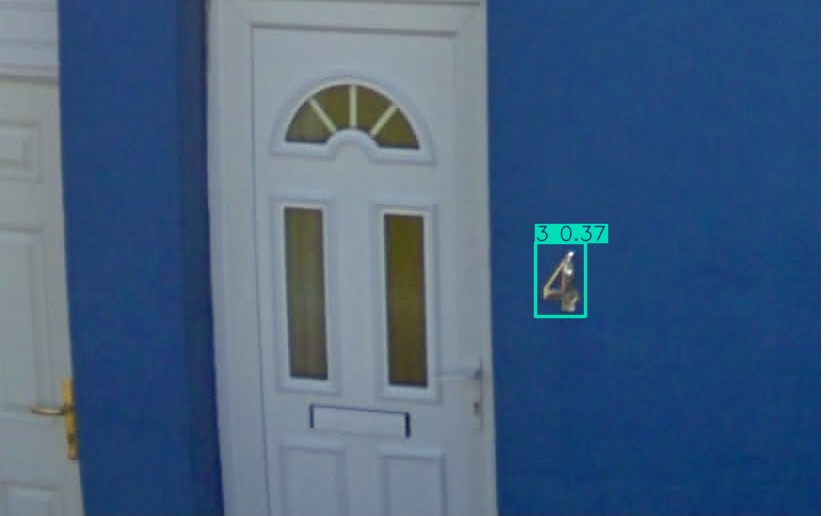

In [125]:
res = model.predict(img)[0]
im_array = res.plot()
im = Image.fromarray(im_array[..., ::-1])
im

In [140]:
# test the model on manually collected data
from torchvision.transforms.functional import rotate, resize

# total number of photos = 39
rows = 8
cols = 5
fig = plt.figure(figsize=(10 * cols, 10 * rows))

def get_photo(idx):
    res = Image.open(f'photos/{idx}.jpg')
    res = rotate(res, -90.0)
    res = resize(res, 640)
    return res

for i in range(1, cols * rows):
    fig.add_subplot(rows, cols, i)
    res = model.predict(get_photo(i))[0]
    im_array = res.plot()
    im = Image.fromarray(im_array[..., ::-1])
    plt.imshow(im)
plt.savefig('photos_boxes.png')


0: 640x640 1 4, 114.1ms
Speed: 234.9ms preprocess, 114.1ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 16.0ms
Speed: 2.0ms preprocess, 16.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 5s, 16.5ms
Speed: 0.0ms preprocess, 16.5ms inference, 8.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 17.0ms
Speed: 3.2ms preprocess, 17.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 1, 1 3, 1 7, 10.3ms
Speed: 2.0ms preprocess, 10.3ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 15.8ms
Speed: 3.0ms preprocess, 15.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 1, 1 3, 1 7, 18.6ms
Speed: 0.0ms preprocess, 18.6ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 16.0ms
Speed: 2.8ms preprocess, 16.0ms inference, 2.3ms postpro

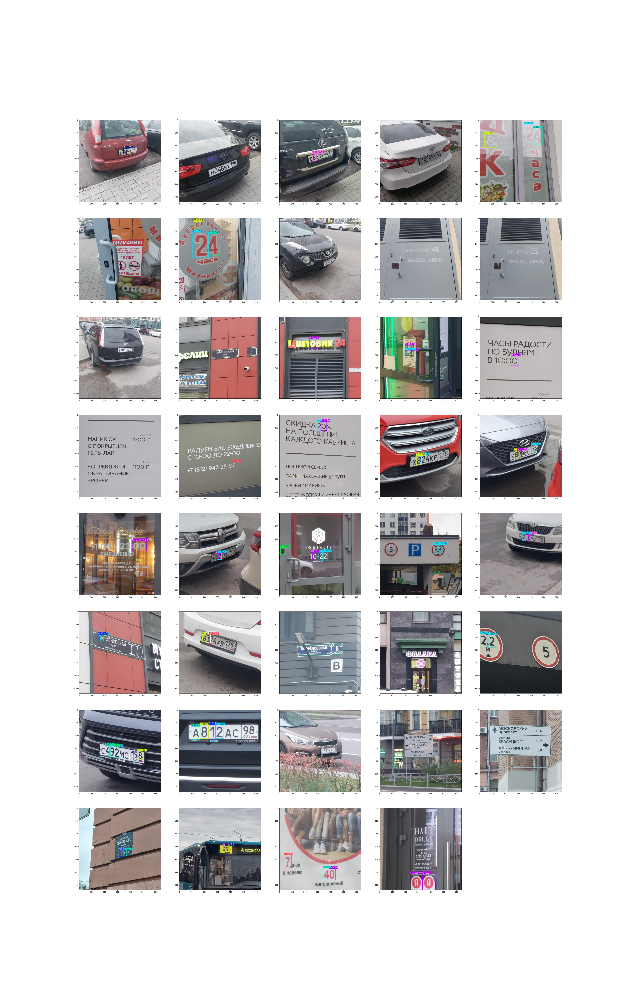

In [ ]:
# сравнить с yolo11

Image.open('photos_boxes.png')